ダウンロードするもの:
- [日本語フォント](https://fonts.google.com/noto/specimen/Noto+Sans+JP)  
- [tags.csv](https://github.com/konbraphat51/NicoDataCleaner/blob/main/NicoTagDataCleaner.ipynb)



## 時系列Word Vectorデータを作成

In [ ]:
import pandas as pd

In [ ]:
df = pd.read_csv("/content/tags.csv", names=["date", "tag"])

df["date"] = pd.to_datetime(df["date"])

df.head(5)

,date,tag
0,2007-03-09 19:21:35+09:00,ゲームCM
1,2007-03-09 19:21:35+09:00,ゼルダノ伝説(初代)
2,2007-03-09 19:21:35+09:00,ニューファミコン
3,2007-03-09 19:21:35+09:00,ファミコン
4,2007-03-09 19:21:35+09:00,ファミリーコンピュータ


In [ ]:
df["year"] = df["date"].dt.year

df["year"].unique()

array([2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017,
       2018, 2019, 2020, 2021])

In [ ]:
timelapse = []

for year in df["year"].unique():
  df_year = df[df["year"] == year]
  counter = df_year["tag"].value_counts()[:100]

  word_vector = counter.to_dict()

  timelapse.append((str(year), word_vector))

## AnimatedWordCloudに適用

In [ ]:
!pip install AnimatedWordCloudTimelapse==1.0.5

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 6.6 MB/s eta 0:00:00
  Attempting uninstall: AnimatedWordCloudTimelapse
    Found existing installation: AnimatedWordCloudTimelapse 1.0.0
    Uninstalling AnimatedWordCloudTimelapse-1.0.0:
      Successfully uninstalled AnimatedWordCloudTimelapse-1.0.0


In [ ]:
from AnimatedWordCloud import animate, Config

config = Config(
    font_path="/content/NotoSansJP-VariableFont_wght.ttf",
    output_path="/content/",
    image_width=1600,
    image_height=1200,
    verbosity="debug"
)

result = animate(timelapse, config)

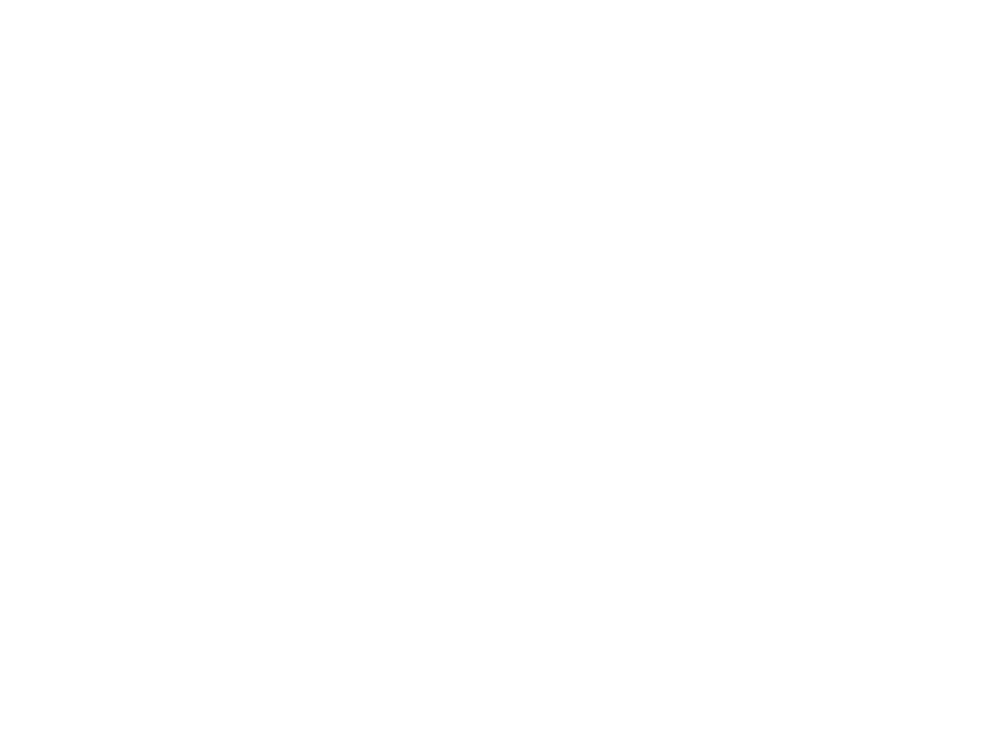

In [ ]:
from IPython.display import display, Image

with open('/content/output.gif','rb') as f:
    display(Image(data=f.read(), format='png'))